<a href="https://colab.research.google.com/github/cissara/cissara/blob/main/Curso_Stable_Diffusion_Parte_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Stable Diffusion





**`[ ! Atenção ]`** É importante verificar a licença dos modelos, especialmente se você pretende fazer algum uso comercial com os resultados obtidos.

A licença é projetada para mitigar os possíveis efeitos nocivos de um sistema de aprendizado de máquina tão poderoso. Pedimos que caso façam o uso das imagens leiam com atenção a licença e com cuidado. Aqui um resumo:



```
1. You can't use the model to deliberately produce nor share illegal or harmful outputs or content,
2. We claim no rights on the outputs you generate, you are free to use them and are accountable for their use which should not go against the provisions set in the license, and
3. You may re-distribute the weights and use the model commercially and/or as a service. If you do, please be aware you have to include the same use restrictions as the ones in the license and share a copy of the CreativeML OpenRAIL-M to all your users.
```
(Licença do v1.4 e v1.5 https://huggingface.co/spaces/CompVis/stable-diffusion-license)


In [ ]:
!nvidia-smi

Fri Aug 11 10:58:40 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Atualização

`[ ! ] Atualização em outubro de 2023:` nesse momento há uma incompatibilidade entre o xformers (módulo usado para otimizar a geração das imagens) e as versões mais recentes da biblioteca Pytorch, que passaram a ser atribuídas bem recentemente às novas sessões no Colab. Portanto, nossa recomendação é fazer o downgrade do torch para versão 1.13.1, pois atualmente o xformers funciona melhor para essa versão.

Para isso, utilize o comando `!pip install torch==1.13.1`. Execute ele antes de todo o restante de seu código (e reinicie o ambiente de execução antes, caso já tenha iniciado) e pode continuar executando normalmente o resto do código.

In [ ]:
!pip install torch==1.13.1 torchvision==0.14.1 torchaudio==0.13.1 torchdata==0.5.1 torchtext==0.14.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.2/24.2 MB 49.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 73.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 66.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 95.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.3/849.3 kB 52.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 557.1/557.1 MB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1 MB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 76.2 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 2.1.0+cu118
    Uninstalling torch-2.1.0+cu118:
      Successfully uninstalled torch-2.1.0+cu118
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.16.0+cu118
    Uninstal

## Instalação das bibliotecas

- [xformers](https://github.com/facebookresearch/xformers) para otimização da memória



In [ ]:
!pip install diffusers==0.11.1
!pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 gradio natsort safetensors xformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.4/261.4 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 MB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 94.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.8/211.8 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.9/92.9 kB 10.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.7/302.7 kB 25.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.0/75.0 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.7/138.7 kB 15.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 381.6/381.6 kB 34.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 4.

## Pipeline para geração da imagem

Podemos definir com pouco esforço um pipeline para utilizar o modelo do Stable Diffusion, através do [StableDiffusionPipeline](https://github.com/huggingface/diffusers/blob/main/src/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py)



  > **Pipeline** -  Um pipeline é uma classe end-to-end que fornece uma maneira rápida e fácil de usar um sistema de difusão para inferência agrupando modelos e schedulers treinados independentemente. Certas combinações de modelos e agendadores definem tipos de pipeline específicos, como `StableDiffusionPipeline` ou `StableDiffusionControlNetPipeline`, com recursos específicos. Todos os tipos de pipeline herdam da classe base `DiffusionPipeline`; basta passar o checkpoint e ele detectará automaticamente o tipo de pipeline e carregará os componentes necessários.

Utilizaremos a função `from_pretrained` para especificar de qual modelo queremos carregar os pesos. A função escrita para esse módulo diffusers está preparada para fazer o download automático do modelo.


**Observação:** Se você estiver limitado pela memória da GPU e tiver menos de 10 GB de RAM da GPU disponível, certifique-se de carregar o StableDiffusionPipeline na precisão float16 em vez da precisão float32 padrão, conforme feito acima.

Como estamos usando a versão gratuita do Google Colab, não temos controle de qual GPU será atribuída. Como queremos garantir que todos possam executar o modelo, vamos especificar como parâmetro na função o `torch_dtype` com o valor `torch.float16`.
E para isso funcionar, estaremos carregando os pesos do branch de meia precisão (*half-precision branch*) fp16. Mais informações [aqui](https://huggingface.co/CompVis/stable-diffusion-v1-4/tree/fp16)




In [ ]:
import torch
from diffusers import StableDiffusionPipeline

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16)

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

text_encoder/pytorch_model.fp16.safetensors not found


Fetching 30 files:   0%|          | 0/30 [00:00<?, ?it/s]

safety_checker/config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

(…)kpoints/scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

pytorch_model.fp16.bin:   0%|          | 0.00/608M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

pytorch_model.fp16.bin:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.bin:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

diffusion_pytorch_model.non_ema.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

(…)fusion_pytorch_model.non_ema.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.bin:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


In [ ]:
pipe = pipe.to('cuda')

Antes de realizar a inferência, é recomendado habilitar o [enable_attention_slicing()](https://huggingface.co/docs/diffusers/v0.16.0/en/api/pipelines/stable_diffusion/latent_upscale#diffusers.StableDiffusionLatentUpscalePipeline.enable_attention_slicing) na pipeline.
Para otimizar o uso da memória você pode usar ainda mais um método, que além de resultar em um menor uso de memória da GPU vai levar a uma possível aceleração no tempo de inferência (mais informações: https://huggingface.co/docs/diffusers/v0.16.0/en/api/pipelines/stable_diffusion/latent_upscale#diffusers.StableDiffusionLatentUpscalePipeline.enable_xformers_memory_efficient_attention)


In [ ]:
pipe.enable_attention_slicing()
pipe.enable_xformers_memory_efficient_attention()

### Definição do prompt

In [ ]:
prompt = 'an apple'

### Geração da imagem



In [ ]:
img = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
type(img)

PIL.Image.Image

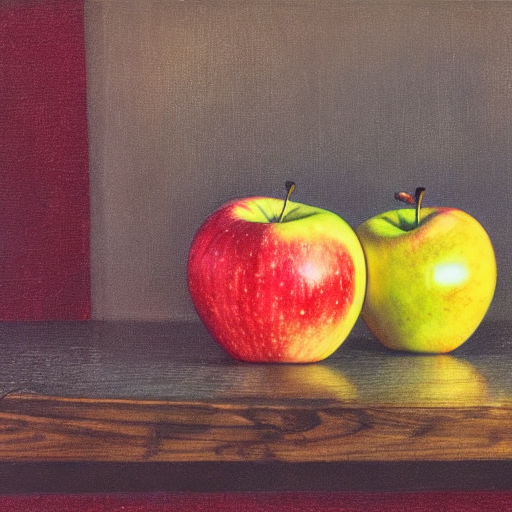

In [ ]:
img

  0%|          | 0/50 [00:00<?, ?it/s]

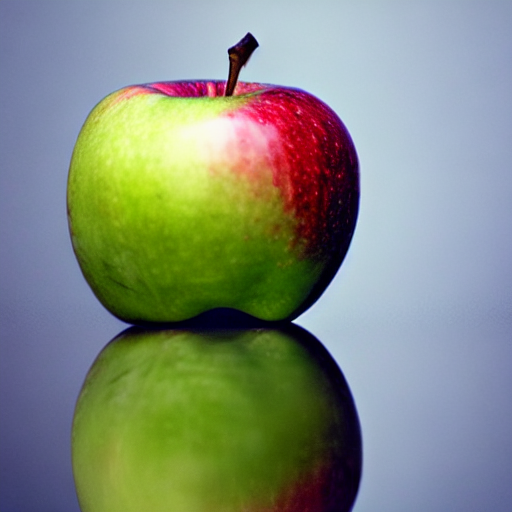

In [ ]:
prompt = 'photograph of an apple'
img = pipe(prompt).images[0]
img

### Salvando o resultado

In [ ]:
img.save('resultado.png')

  0%|          | 0/50 [00:00<?, ?it/s]

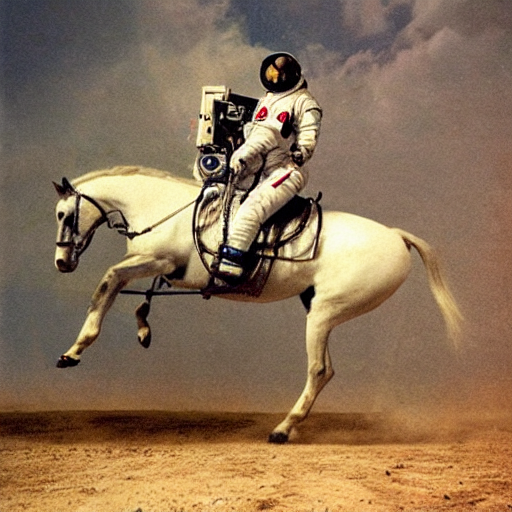

In [ ]:
prompt = 'a photograph of an astronaut riding a horse, color'
img = pipe(prompt).images[0]
img

In [ ]:
img.size

(512, 512)

## Gerando vários resultados

In [ ]:
from PIL import Image

def grid_img(imgs, rows=1, cols=3, scale=1):
  assert len(imgs) == rows * cols

  w, h = imgs[0].size
  w, h = int(w * scale), int(h * scale)

  grid = Image.new('RGB', size = (cols * w, rows * h))
  grid_w, grid_h = grid.size

  for i, img in enumerate(imgs):
    img = img.resize((w, h), Image.ANTIALIAS)
    grid.paste(img, box=(i % cols * w, i // cols * h))
  return grid

  0%|          | 0/50 [00:00<?, ?it/s]

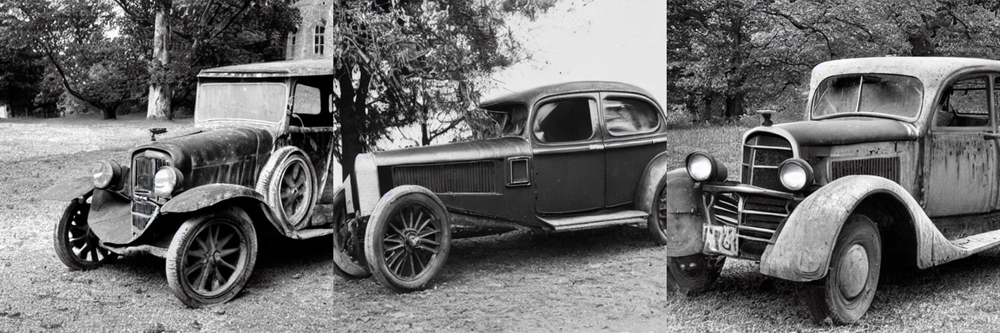

In [ ]:
num_imgs = 3
prompt = 'photograph of an old car'
imgs = pipe(prompt, num_images_per_prompt=num_imgs).images
grid = grid_img(imgs, rows = 1, cols = 3, scale = 0.75)
grid

## Parâmetros

### Seed




  0%|          | 0/50 [00:00<?, ?it/s]

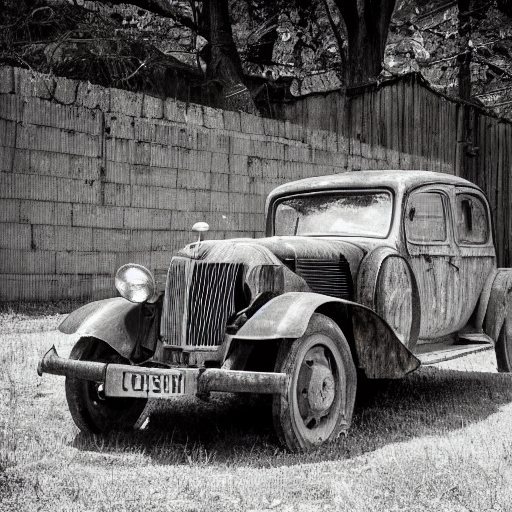

In [ ]:
seed = 777
generator = torch.Generator('cuda').manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

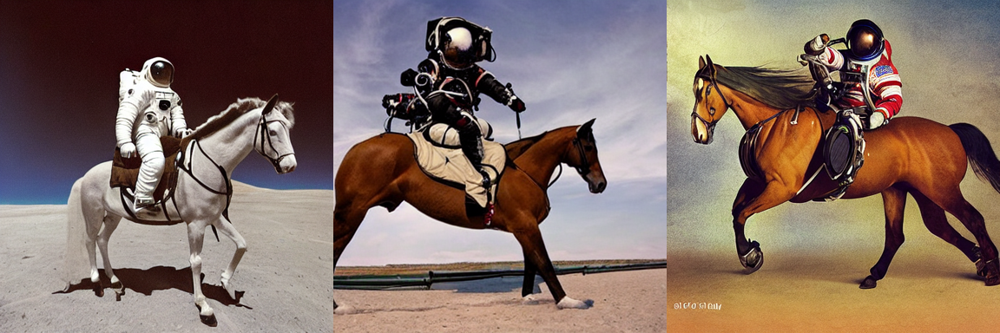

In [ ]:
prompt = "a photograph of an astronaut riding a horse"
seed = 777
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=num_imgs, generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

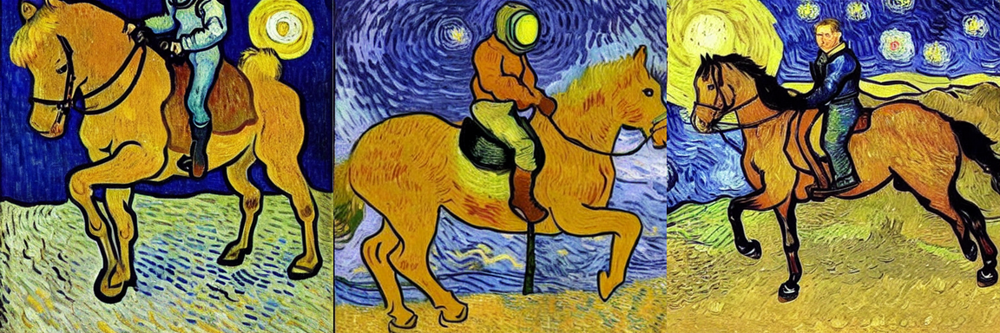

In [ ]:
prompt = "van gogh painting of an astronaut riding a horse"
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=num_imgs, generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### Etapas (Inference steps)

  0%|          | 0/20 [00:00<?, ?it/s]

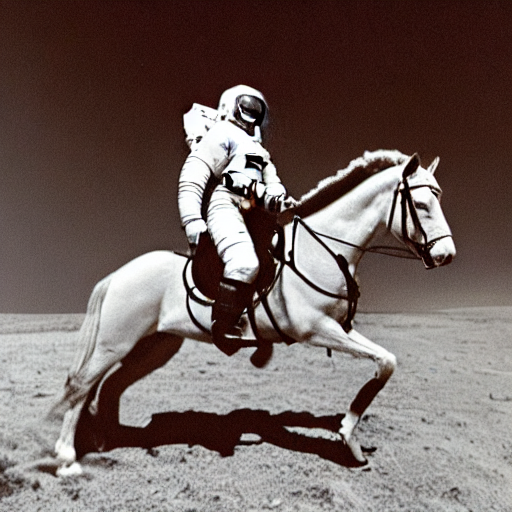

In [ ]:
prompt = "a photograph of an astronaut riding a horse"
generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, num_inference_steps=20, generator=generator).images[0]
img

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

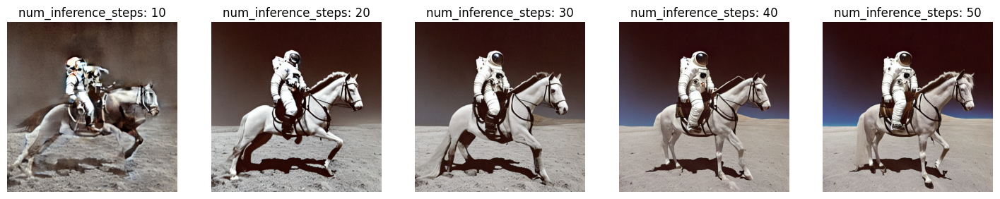

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(18,8))
for i in range(1, 6):
  n_steps = i * 10
  generator = torch.Generator('cuda').manual_seed(seed)
  img = pipe(prompt, num_inference_steps=n_steps, generator=generator).images[0]

  plt.subplot(1, 5, i)
  plt.title('num_inference_steps: {}'.format(n_steps))
  plt.imshow(img)
  plt.axis('off')
plt.show()

### Guidance scale (CFG)


Escolha do melhor valor

* Valores entre 7 e 8.5 geralmente são boas escolhas para o Stable Diffusion. Por padrão, o valor é 7.5

* No geral, você vai querer manter o valor padrão ou algo próximo (5~9). Recomenda-se ficar longe de valores muito baixos ou altos, pois verá que eles retornarão imagens menos realistas

* Definir o valor correto depende dos resultados desejados e também da complexidade do prompt de texto. A decisão é sua, mas é sempre melhor experimentar diferentes escalas para ver se resultados mais criativos ou resultados estritamente aderentes ao prompt são melhores para o seu caso de uso.

Um exemplo de caso de uso: quando o CFG é maior, conceitos do prompt são mais visíveis nas imagens. Se você está tentando gerar uma imagem com mais detalhes minúsculos especificados no prompt, pode começar com uma escala de orientação maior, talvez entre 10 e 18. Mas isso vai depender muito do prompt, ou modelo, portanto não há uma regra geral nesse caso, se você quer o resultado mais próximo do esperado então aproveite para "brincar" testando outros valores.


  0%|          | 0/50 [00:00<?, ?it/s]

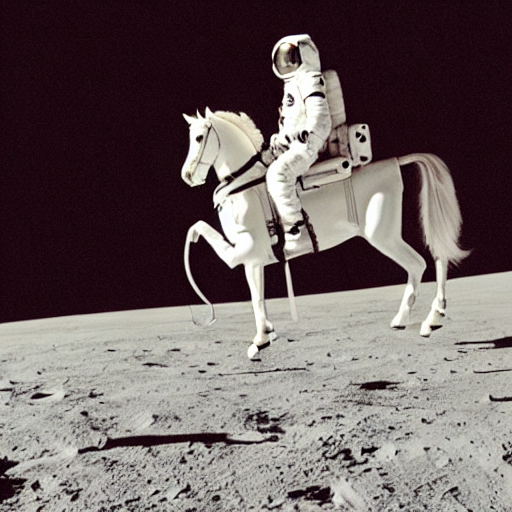

In [ ]:
prompt = "a photograph of an astronaut riding a horse"

generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, guidance_scale=10, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

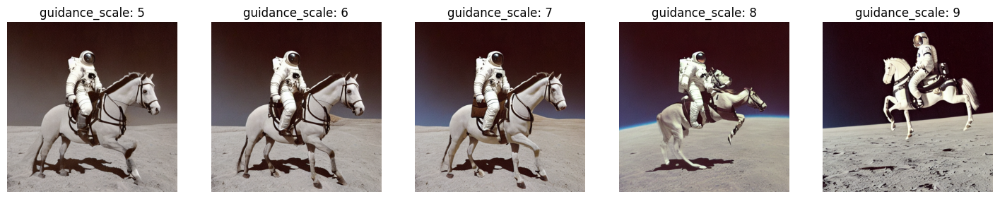

In [ ]:
plt.figure(figsize=(18,8))
for i in range(1, 6):

  n_guidance = i + 4
  generator = torch.Generator("cuda").manual_seed(seed)
  img = pipe(prompt, guidance_scale=n_guidance, generator=generator).images[0]

  plt.subplot(1,5,i)
  plt.title('guidance_scale: {}'.format(n_guidance))
  plt.imshow(img)
  plt.axis('off')

plt.show()

### Tamanho da imagem (proporção e orientação)

Por padrão, esse modelo do Stable Diffusion irá produzir imagens de 512 × 512 pixels. Mas é muito fácil substituir o padrão usando os argumentos de altura e largura.

Caso deseje alterar o tamanhos das imagem, há algumas recomendações:

* certifique-se de que a altura e a largura sejam múltiplos de 8.
* menor que 512 irá resultar em imagens de qualidade inferior.
* ultrapassar 512 em ambas as direções repetirá as áreas da imagem (portanto, perde-se a "coerência global").
* a melhor maneira de criar imagens não quadradas é usar 512 em uma dimensão (altura ou largura) e um valor maior na outra.

> Modo paisagem


  0%|          | 0/50 [00:00<?, ?it/s]

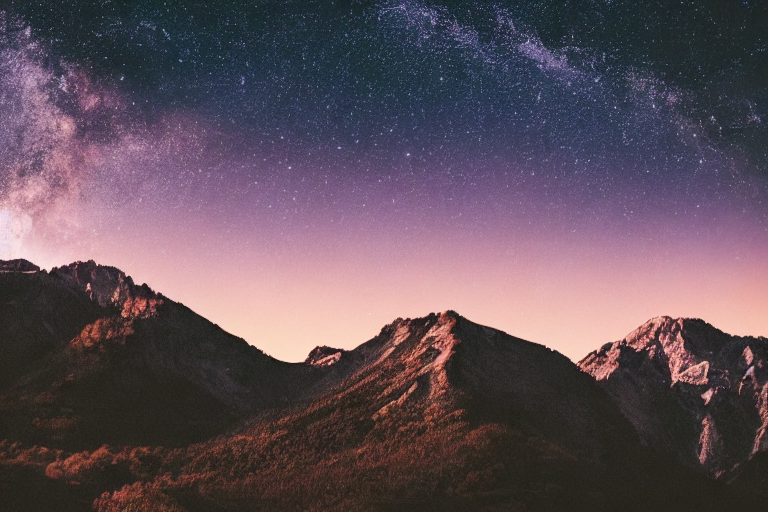

In [ ]:
seed = 777
prompt = "photograph of a mountain landscape during sunset, stars in the sky"
generator = torch.Generator("cuda").manual_seed(seed)

h, w = 512, 768

img = pipe(prompt, height=h, width=w, generator=generator).images[0]

img

> Modo retrato



  0%|          | 0/50 [00:00<?, ?it/s]

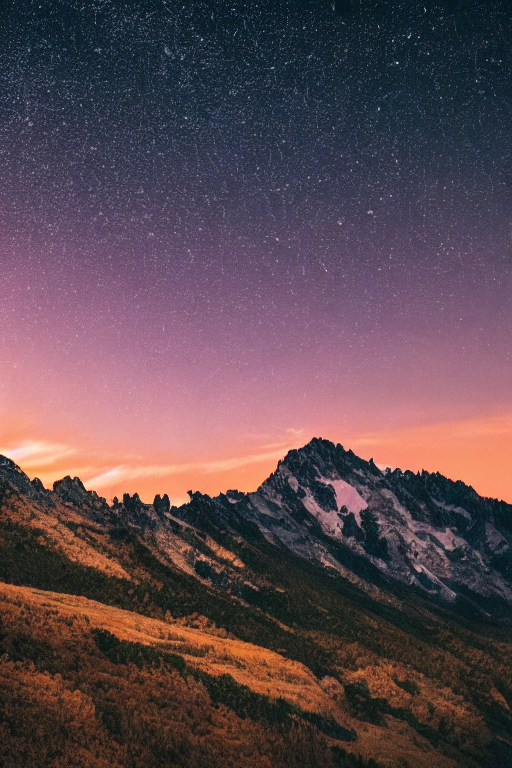

In [ ]:
generator = torch.Generator("cuda").manual_seed(seed)

h, w = 768, 512

img = pipe(prompt, height=h, width=w, generator=generator).images[0]

img

### Prompt negativo

  0%|          | 0/50 [00:00<?, ?it/s]

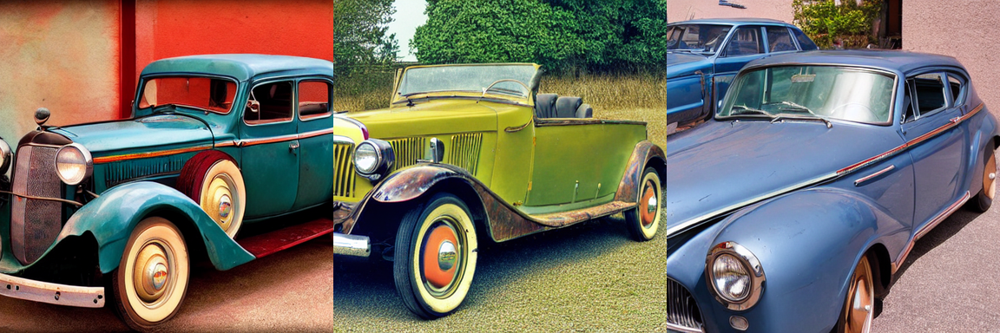

In [ ]:
num_images = 3

prompt = 'photograph of an old car'
neg_prompt = 'bw photo'

imgs = pipe(prompt, negative_prompt = neg_prompt, num_images_per_prompt = num_images).images

grid = grid_img(imgs, rows = 1, cols = 3, scale = 0.75)
grid

## Outros modelos

### SD v1.5

In [ ]:
sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
sd15 = sd15.to('cuda')
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

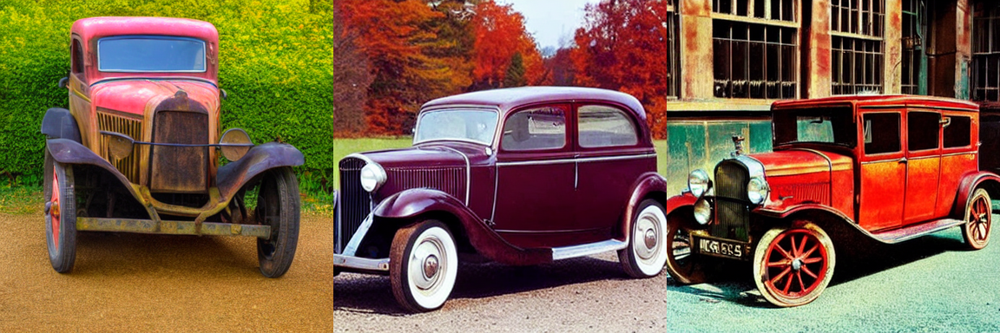

In [ ]:
num_imgs = 3

prompt = "photograph of an old car"
neg_prompt = "bw photo"

imgs = sd15(prompt, negative_prompt=neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

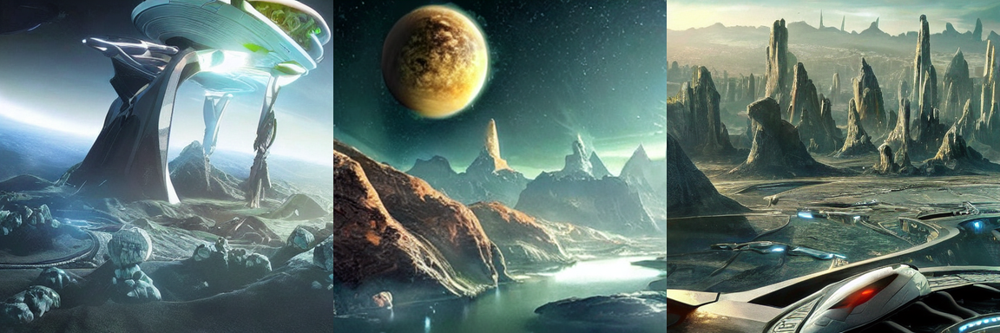

In [ ]:
prompt = "photo of a futuristic city on another planet, realistic, full hd"
neg_prompt = 'buildings'

imgs = sd15(prompt, negative_prompt = neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### SD v2.x

In [ ]:
sd2 = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16)
sd2 = sd2.to("cuda")
sd2.enable_attention_slicing()
sd2.enable_xformers_memory_efficient_attention()

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

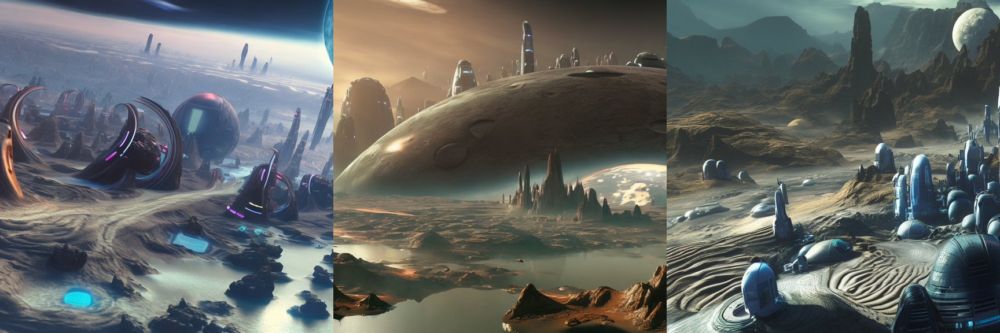

In [ ]:
prompt = "photo of a futuristic city on another planet, realistic, full hd"
neg_prompt = 'buildings'

imgs = sd2(prompt, negative_prompt = neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### Modelos fine-tune com estilos específicos

- Usar um modelo customizado e treinado para um estilo específico é a maneira mais fácil e garantida de chegar a esse estilo.

> Mo-di-diffusion (Modern Disney style)

https://huggingface.co/nitrosocke/mo-di-diffusion



In [ ]:
modi = StableDiffusionPipeline.from_pretrained("nitrosocke/mo-di-diffusion", torch_dtype=torch.float16)
modi = modi.to("cuda")
modi.enable_attention_slicing()
modi.enable_xformers_memory_efficient_attention()

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


Seed: 


  0%|          | 0/50 [00:00<?, ?it/s]

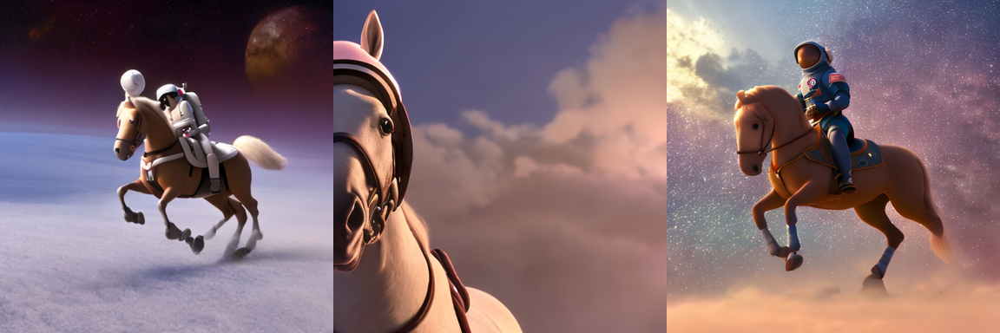

In [ ]:
prompt = "a photograph of an astronaut riding a horse, modern disney style"

seed = 777
print("Seed: ".format(str(seed)))

generator = torch.Generator("cuda").manual_seed(seed)

imgs = modi(prompt, generator=generator, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

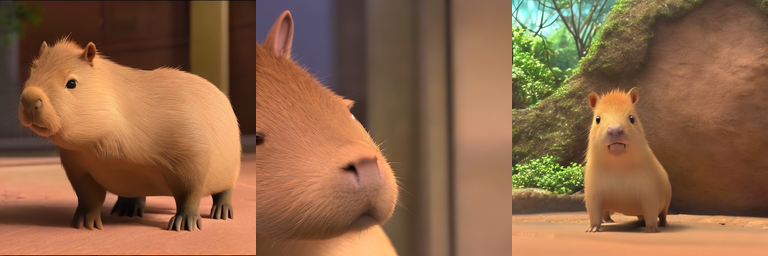

In [ ]:
prompt = "capybara, modern disney style"

generator = torch.Generator("cuda").manual_seed(seed)
imgs = modi(prompt, generator=generator, num_images_per_prompt=3).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.5)
grid

Seed: 


  0%|          | 0/50 [00:00<?, ?it/s]

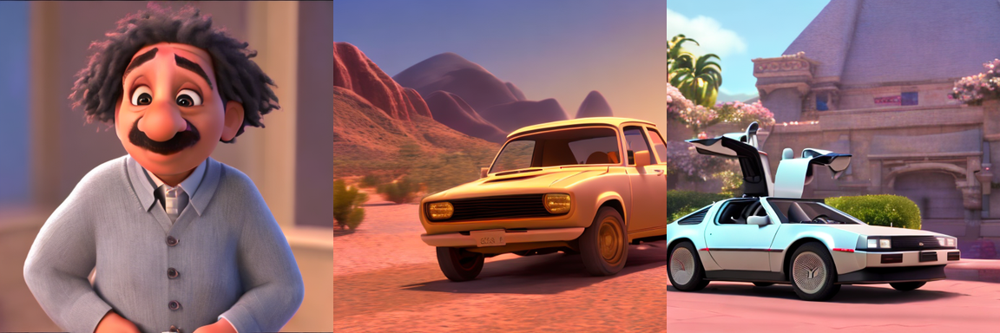

In [ ]:
prompt = ["albert einstein, modern disney style",
          "modern disney style old chevette driving in the desert, golden hour",
          "modern disney style delorean"]
neg_prompt = [""] * len(prompt)

seed = 777

print("Seed: ".format(str(seed)))
generator = torch.Generator("cuda").manual_seed(seed)
imgs = modi(prompt, generator=generator, negative_prompt=neg_prompt).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

#### Outros

* Classic Disney Style - https://huggingface.co/nitrosocke/classic-anim-diffusion

* Animação 3D em alta resolução - https://huggingface.co/nitrosocke/redshift-diffusion

* Imagens futuristas / ficção científica - https://huggingface.co/nitrosocke/Future-Diffusion

* E outros estilos de animação:
 * https://huggingface.co/nitrosocke/Ghibli-Diffusion
 * https://huggingface.co/nitrosocke/spider-verse-diffusion
* e mais uma infinidade de modelos https://huggingface.co/models?other=stable-diffusion-diffusers (o céu e a criatividade são o limite)

Mais alguns outros modelos:


  "nitrosocke/Arcane-Diffusion",
  "nitrosocke/archer-diffusion",
  "nitrosocke/elden-ring-diffusion",
  "nitrosocke/spider-verse-diffusion",
  "nitrosocke/modern-disney-diffusion",
  "hakurei/waifu-diffusion",
  "lambdalabs/sd-pokemon-diffusers",
  "yuk/fuyuko-waifu-diffusion",
  "AstraliteHeart/pony-diffusion",
  "nousr/robo-diffusion",
  "DGSpitzer/Cyberpunk-Anime-Diffusion",
  "sd-dreambooth-library/herge-style"



## Modificação do Scheduler (sampler)

Em termos bastantes simplificados, é a algoritmo e matemática que o SD usa para a geração.

Lista de schedulers disponíveis:
https://huggingface.co/docs/diffusers/using-diffusers/schedulers#schedulers-summary


In [ ]:
!pip install diffusers==0.11.1
!pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 gradio natsort safetensors xformers

import torch
from diffusers import StableDiffusionPipeline

sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
sd15 = sd15.to("cuda")
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

In [ ]:
pipe.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.11.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "trained_betas": null
}

Padrão é o [PNDMScheduler](https://github.com/huggingface/diffusers/blob/main/src/diffusers/schedulers/scheduling_pndm.py).


  0%|          | 0/50 [00:00<?, ?it/s]

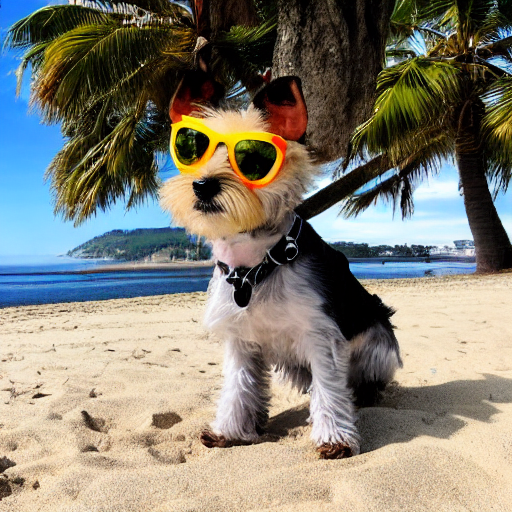

In [ ]:
seed = 777
prompt = "a photo of a terrier wearing sunglasses, on the beach, ocean in the background"

generator = torch.Generator("cuda").manual_seed(seed)

img = pipe(prompt, generator=generator).images[0]

img

In [ ]:
pipe.scheduler.compatibles

[diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler]

In [ ]:
pipe.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('skip_prk_steps', True),
            ('set_alpha_to_one', False),
            ('prediction_type', 'epsilon'),
            ('steps_offset', 1),
            ('_class_name', 'PNDMScheduler'),
            ('_diffusers_version', '0.11.1'),
            ('clip_sample', False)])

In [ ]:
from diffusers import DDIMScheduler
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

  0%|          | 0/50 [00:00<?, ?it/s]

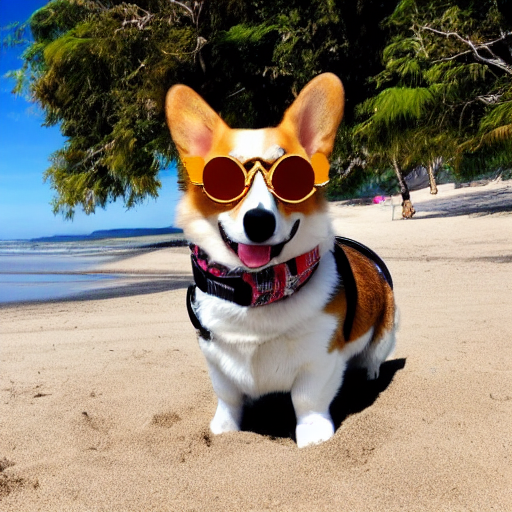

In [ ]:
generator = torch.Generator(device="cuda").manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

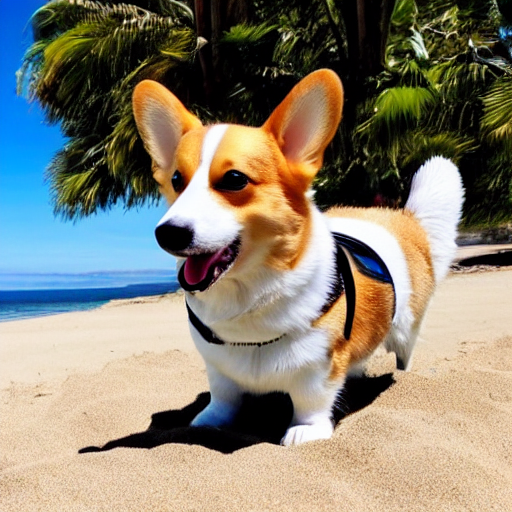

In [ ]:
from diffusers import LMSDiscreteScheduler

pipe.scheduler = LMSDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

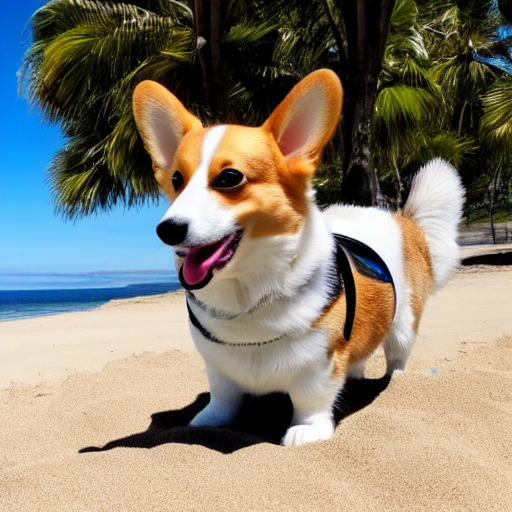

In [ ]:
from diffusers import EulerDiscreteScheduler

pipe.scheduler = EulerDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = pipe(prompt, generator=generator, num_inference_steps=50).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

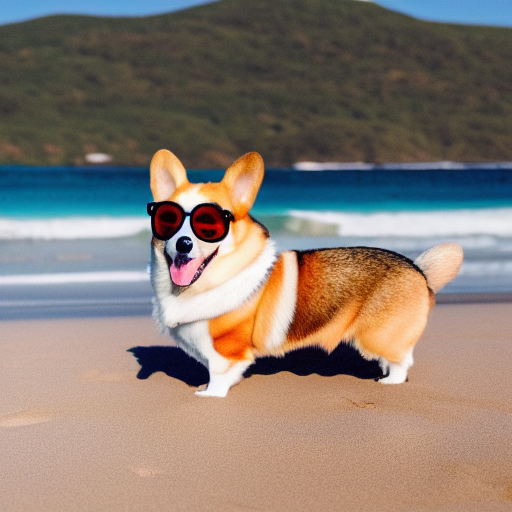

In [ ]:
from diffusers import EulerAncestralDiscreteScheduler

pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = pipe(prompt, generator=generator, num_inference_steps=50).images[0]
img